In [1]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import anndata
import dynamo as dyn
import scanpy as sc
dyn.get_all_dependencies_version()

package,pandas,typing-extensions,tqdm,statsmodels,setuptools,seaborn,scipy,scikit-learn,pynndescent,numpy,numba,networkx,matplotlib,igraph,dynamo-release,anndata,umap-learn,session-info,loompy,numdifftools,colorcet,pre-commit,get-version,openpyxl
version,2.2.3,4.9.0,4.66.5,0.14.2,68.2.2,0.13.2,1.12.0,1.1.3,0.5.13,1.23.5,0.60.0,3.3,3.6.2,0.10.8,1.4.0,0.10.8,0.5.5,1.0.0,3.0.7,0.9.41,3.0.1,3.3.2,3.5.4,3.2.0b1


In [212]:
from random import seed, uniform
from typing import List, Optional, Tuple, Union

In [219]:
def hill_act_func(x: float, A: float, K: float, n: float, g: float = 0) -> float:
    
    Kd = K**n
    return A * x**n / (Kd + x**n) - g * x

def hill_inh_func(x: float, A: float, K: float, n: float, g: float = 0) -> float:

    Kd = K**n
    return A * Kd / (Kd + x**n) - g * x

def ode_cancer(
    x: np.ndarray,
    a: List = [0.5, 0.5, 0.8, 0.8, 0.5, 0.5, 0.8],
    b: List = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
    S: List = [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5],
    K: List = [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5],
    m: List = [4, 4, 4, 4, 4, 4, 4],
    n: List = [4, 4, 4, 4, 4, 4, 4, 4, 4],
    gamma: List = [1, 1, 1, 1, 1, 1],
) -> np.ndarray:
    """2015Cancer Research Quantifying the Landscape for Development and Cancer from a Core Cancer Stem Cell Circuit"""
    d = x.ndim
    x = np.atleast_2d(x)
    dx = np.zeros(x.shape)
    
    dx[:, 0] = hill_act_func(x[:, 0], a[3], S[3], m[3], g=gamma[2]) + hill_inh_func(x[:, 4], b[3], K[3], n[3])
    # p53
    dx[:, 1] = hill_act_func(x[:, 1], a[2], S[2], m[2], g=gamma[1]) + hill_inh_func(x[:, 2], b[1], K[1], n[1]) + hill_inh_func(x[:, 3], b[2], K[2], n[2])
    # ZEB
    dx[:, 2] = hill_act_func(x[:, 0], a[0], S[0], m[0], g=gamma[0]) + hill_act_func(x[:, 5], a[1], S[1], m[1]) + hill_inh_func(x[:, 1], b[0], K[0], n[0])
    # miR-200
    dx[:, 3] = hill_act_func(x[:, 0], a[4], S[4], m[4], g=gamma[3]) + hill_inh_func(x[:, 1], b[4], K[4], n[4]) + hill_inh_func(x[:, 5], b[5], K[5], n[5])
    # miR-145
    dx[:, 4] = hill_act_func(x[:, 0], a[5], S[5], m[5], g=gamma[4]) + hill_inh_func(x[:, 3], b[6], K[6], n[6])
    # MDM2
    dx[:, 5] = hill_act_func(x[:, 5], a[6], S[6], m[6], g=gamma[5]) + hill_inh_func(x[:, 0], b[7], K[7], n[7]) + hill_inh_func(x[:, 3], b[8], K[8], n[8])
    # OCT4

    if d == 1:
        dx = dx.flatten()

    return dx

def state_space_sampler(ode, dim, seed_num=19491001, clip=True, min_val=0, max_val=4, N=10000):
    
    seed()
    X = np.array([[uniform(min_val, max_val) for _ in range(dim)] for _ in range(N)])
    Y = np.clip(X + ode(X), a_min=min_val, a_max=None) if clip else X + ode(X)

    return X, Y

In [220]:
def Simulator(
    motif: str = "cancer", seed_num=19491001, clip: Optional[bool] = None, cell_num: int = 5000
) -> anndata.AnnData:

    if motif == "cancer":
        X, Y = state_space_sampler(
            ode=ode_cancer,
            dim=6,
            min_val=0,
            max_val=1.5,
            N=cell_num,
            clip=True if clip is None else clip,
        )
        gene_name = np.array(["p53", "ZEB", "miR-200", "miR-145", "MDM2", "OCT4"])

    var = pd.DataFrame({"gene_short_name": gene_name})  # use the real name in simulation?
    var.set_index("gene_short_name", inplace=True)

    # provide more annotation for cells next:
    cell_ids = ["cell_%d" % (i) for i in range(cell_num)]  # first n_traj and then steps
    obs = pd.DataFrame({"Cell_name": cell_ids})
    obs.set_index("Cell_name", inplace=True)

    layers = {"velocity": Y - X}  # ambiguous is required for velocyto

    adata = anndata.AnnData(X.copy(), obs.copy(), var.copy(), layers=layers.copy())

    adata = adata[adata.X.sum(1) > 0, :] if clip else adata

    return adata

In [255]:
adata=Simulator(motif='cancer',seed_num=19491001,clip=None,cell_num=10000)

In [256]:
adata

AnnData object with n_obs × n_vars = 10000 × 6
    layers: 'velocity'

In [9]:
adata.var

""
gene_short_name
p53
ZEB
miR-200
miR-145
MDM2
OCT4


In [257]:
adata.obsm['X_umap'], adata.obsm['velocity_umap'] = adata.X[:,0:2], adata.layers['velocity'][:,0:2]
adata.var['use_for_dynamics'] = True
adata.var['use_for_transition'] = True
adata.var['gamma'] = 1
adata.layers['velocity_S'] = adata.layers['velocity'].copy()
adata.uns['dynamics'] = {}
adata.uns['dynamics']["use_smoothed"] = True
adata.uns['dynamics']["has_splicing"] = True
adata.uns['dynamics']["has_labeling"] = False
adata.uns['dynamics']["NTR_vel"] = False
dyn.tl.neighbors(adata, basis='umap')
adata.uns['dynamics']["est_method"] = 'ols'
adata.uns['dynamics']['experiment_type'] = None

|-----> Start computing neighbor graph...
|-----------> X_data is None, fetching or recomputing...
|-----> fetching X data from layer:None, basis:umap
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


In [258]:
adata.layers['M_s'], adata.layers['M_u'] = adata.X.copy(), adata.X.copy()
adata.obs['ntr'] = 0

In [259]:
adata.obsm['velocity_pca'] = adata.layers['velocity'].copy()

In [260]:
adata

AnnData object with n_obs × n_vars = 10000 × 6
    obs: 'ntr'
    var: 'use_for_dynamics', 'use_for_transition', 'gamma'
    uns: 'dynamics', 'neighbors'
    obsm: 'X_umap', 'velocity_umap', 'velocity_pca'
    layers: 'velocity', 'velocity_S', 'M_s', 'M_u'
    obsp: 'distances', 'connectivities'

In [261]:
dyn.pp.recipe_monocle(adata)

|-----> apply Monocole recipe to adata...
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----> filtering cells...
|-----> 10000 cells passed basic filters.
|-----> filtering gene...
|-----> 6 genes passed basic filters.
|-----> calculating size factor...
|-----? only 6 genes passed basic filtering, but you requested 2000 genes for feature selection. Try lowering the gene selection stringency: {'min_expr_cells': 0, 'min_expr_avg': 0, 'max_expr_avg': inf, 'svr_gamma': None, 'winsorize': False, 'winsor_perc': (1, 99.5), 'sort_inverse': False}
|-----> selecting genes in layer: X, sort method: SVR...
|-----> applying PCA ...
|-----> cell cycle scoring...
|-----> computing cell phase...
|-----? 
Dynamo is not able to perform cell cycle staging for you automatically. 
Since dyn.pl.phase_diagram in dynamo by default colors cells by its cell-cycle stage, 
you need 

In [248]:
adata

AnnData object with n_obs × n_vars = 10000 × 6
    obs: 'ntr', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'velocity_S_Size_Factor', 'initial_velocity_S_cell_size', 'M_s_Size_Factor', 'initial_M_s_cell_size', 'velocity_Size_Factor', 'initial_velocity_cell_size', 'M_u_Size_Factor', 'initial_M_u_cell_size', 'Size_Factor', 'initial_cell_size'
    var: 'use_for_dynamics', 'use_for_transition', 'gamma', 'nCells', 'nCounts', 'pass_basic_filter', 'frac', 'use_for_pca'
    uns: 'dynamics', 'neighbors', 'pp', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection'
    obsm: 'X_umap', 'velocity_umap', 'velocity_pca', 'X_pca', 'X'
    layers: 'velocity', 'velocity_S', 'M_s', 'M_u', 'X_velocity_S', 'X_M_s', 'X_velocity', 'X_M_u'
    obsp: 'distances', 'connectivities'

In [174]:
adata.var['use_for_transition']

gene_short_name
p53        True
ZEB        True
miR-200    True
miR-145    True
MDM2       True
OCT4       True
Name: use_for_transition, dtype: bool

In [32]:
dyn.vf.VectorField(adata, basis='umap')
#dyn.vf.VectorField(adata, basis='pca')

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [46.9275s]
|-----> [VectorField] completed [47.2536s]


In [265]:
# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction
dyn.vf.VectorField(adata, basis='umap', M=500, 
                   #pot_curl_div=True
                  )
dyn.vf.VectorField(adata, basis='pca')

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [44.7750s]
|-----> [VectorField] completed [45.0919s]
|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [45.4273s]
|-

|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


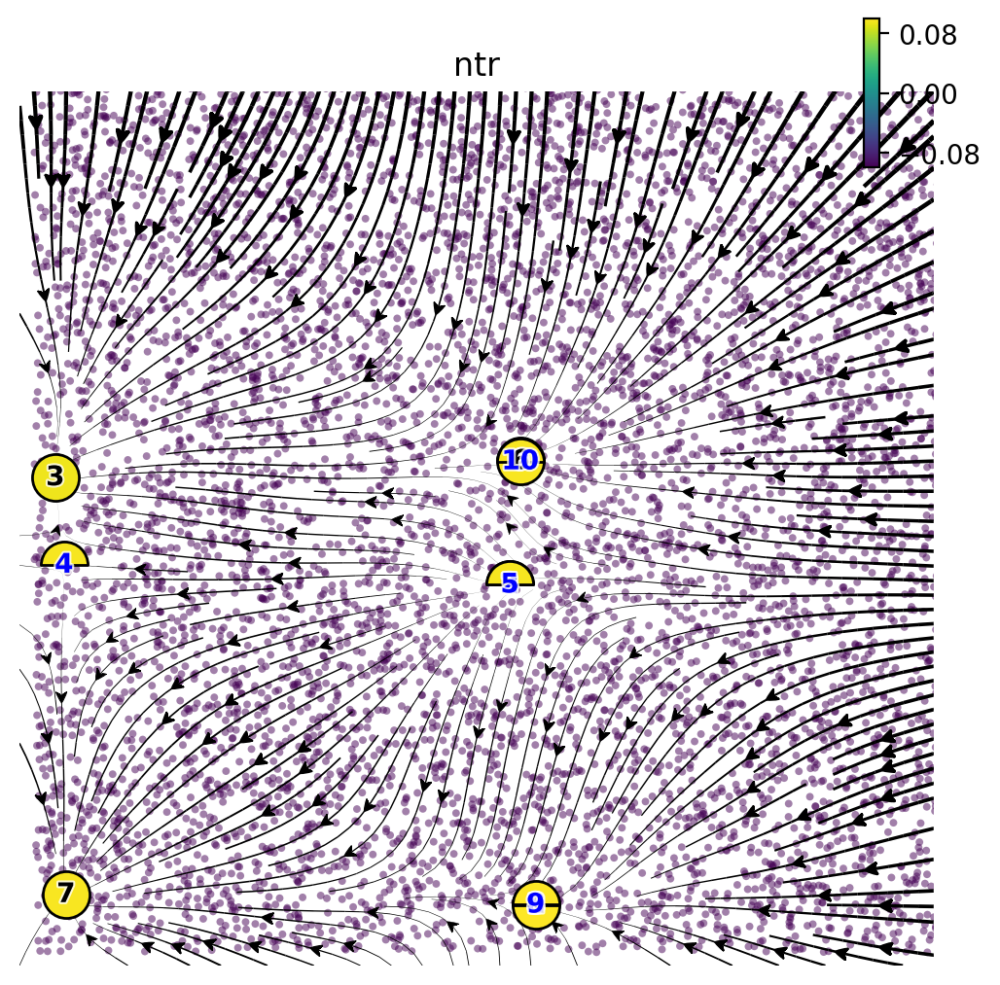

In [267]:
dyn.vf.topography(adata, n=50, basis="umap")
dyn.pl.topography(
        adata, markersize=300, 
        basis="umap", 
        save_show_or_return="show", 
        fps_basis="umap", 
        color="ntr",
        pointsize=0.05,
        streamline_alpha=1, 
        alpha=0.5,
        frontier=False,
        xlim=(-0.02,1.2),
        ylim=(-0.02,1.3),
        figsize=(5,5),
    )

In [269]:
Xss, ftype = adata.uns['VecFld_umap']['Xss'], adata.uns['VecFld_umap']['ftype']
good_fixed_points = [7, 1, 6, 3] #cancer, normal, stem cell, cancer stem cell

adata.uns['VecFld_umap']['Xss'] = Xss[good_fixed_points]
adata.uns['VecFld_umap']['ftype'] = ftype[good_fixed_points]

Saving figure to figure/topography_cancer_good_fixed_points50.pdf...
Done


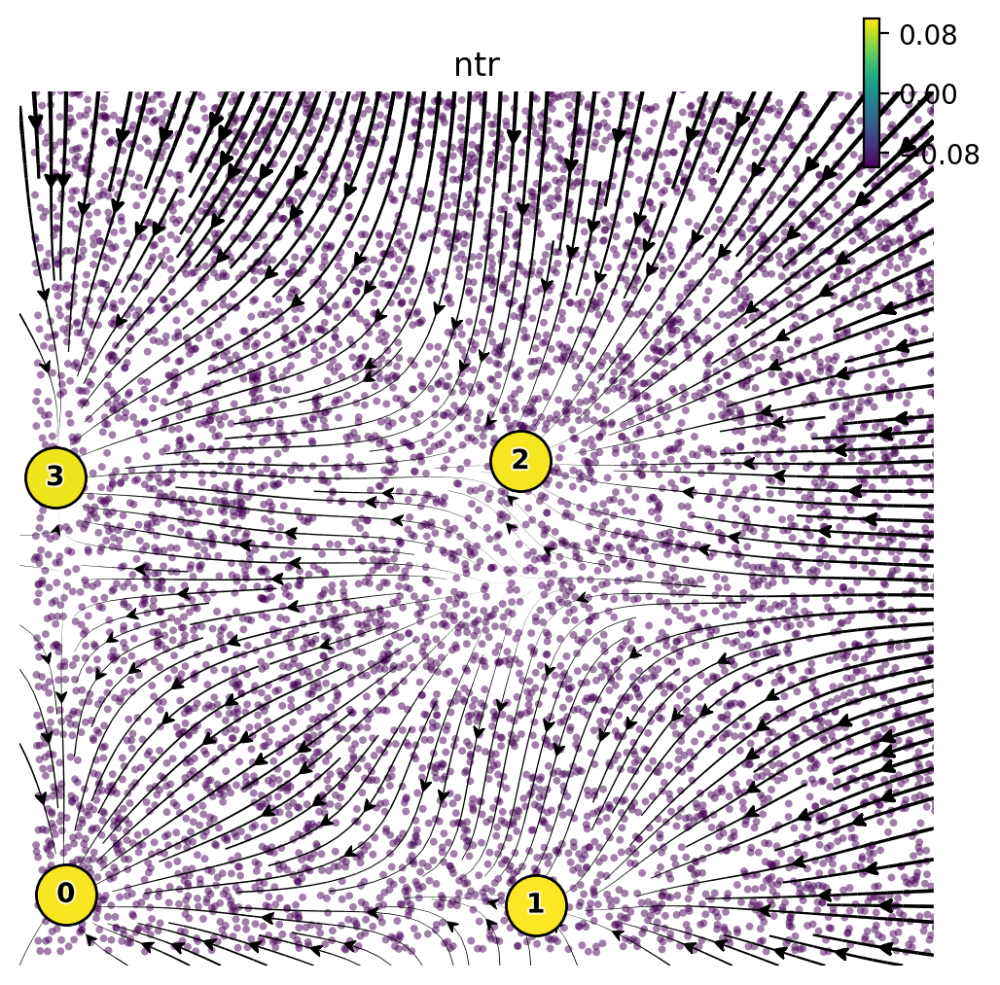

<AxesSubplot: title={'center': 'ntr'}, xlabel='umap_1', ylabel='umap_2'>

In [270]:
dyn.pl.topography(
        adata, markersize=500, 
        basis="umap", 
        save_show_or_return="all", 
        fps_basis="umap", 
        color="ntr",
        pointsize=0.05,
        streamline_alpha=1, 
        frontier=False,
        alpha=0.5,
        xlim=([-0.02,1.2]),
        ylim=(-0.02,1.3),
        figsize=(5,5),
    save_kwargs={'path': 'figure/cancer_good_fixed_points50', 
                 'prefix': 'topography', 
                 'dpi': None, 
                 'ext': 'pdf', 
                 'transparent': True, 
                 'close': True, 
                 'verbose': True},
    )

In [21]:
adata

AnnData object with n_obs × n_vars = 10000 × 6
    obs: 'ntr', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'velocity_S_Size_Factor', 'initial_velocity_S_cell_size', 'M_s_Size_Factor', 'initial_M_s_cell_size', 'velocity_Size_Factor', 'initial_velocity_cell_size', 'M_u_Size_Factor', 'initial_M_u_cell_size', 'Size_Factor', 'initial_cell_size', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap'
    var: 'use_for_dynamics', 'use_for_transition', 'gamma', 'nCells', 'nCounts', 'pass_basic_filter', 'frac', 'use_for_pca'
    uns: 'dynamics', 'neighbors', 'pp', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'VecFld_umap'
    obsm: 'X_umap', 'velocity_umap', 'X_pca', 'X', 'velocity_umap_SparseVFC', 'X_umap_SparseVFC'
    layers: 'velocity', 'velocity_S', 'M_s', 'M_u', 'X_velocity_S', 'X_M_s', 'X_velocity', 'X_M_u'
    obsp: 'distances', 'connectivities'

In [275]:
dyn.tl.cell_velocities(adata, method='cosine',)

|-----> [calculating transition matrix via cosine kernel with sqrt transform.] in progress: 100.0000%|-----> [calculating transition matrix via cosine kernel with sqrt transform.] completed [1.3809s]
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [1.7062s]
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


AnnData object with n_obs × n_vars = 10000 × 6
    obs: 'ntr', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'velocity_S_Size_Factor', 'initial_velocity_S_cell_size', 'M_s_Size_Factor', 'initial_M_s_cell_size', 'velocity_Size_Factor', 'initial_velocity_cell_size', 'M_u_Size_Factor', 'initial_M_u_cell_size', 'Size_Factor', 'initial_cell_size', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca'
    var: 'use_for_dynamics', 'use_for_transition', 'gamma', 'nCells', 'nCounts', 'pass_basic_filter', 'frac', 'use_for_pca'
    uns: 'dynamics', 'neighbors', 'pp', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'VecFld_umap', 'VecFld_pca', 'grid_velocity_umap'
    obsm: 'X_umap', 'velocity_umap', 'velocity_pca', 'X_pca', 'X', 'velocity_umap_SparseVFC', 'X_umap_SparseVFC', 'velocity_pca_SparseVFC', 'X_pca_SparseVFC'
    layers: 'velocity', 'velocity_S', 'M_s', 'M_u', 'X_velocity_S', 'X_M_s',

In [279]:
dyn.tl.cell_velocities(adata, method='cosine',basis='pca')

Using existing cosine_transition_matrix found in .obsp.
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [1.7778s]
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


AnnData object with n_obs × n_vars = 10000 × 6
    obs: 'ntr', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'velocity_S_Size_Factor', 'initial_velocity_S_cell_size', 'M_s_Size_Factor', 'initial_M_s_cell_size', 'velocity_Size_Factor', 'initial_velocity_cell_size', 'M_u_Size_Factor', 'initial_M_u_cell_size', 'Size_Factor', 'initial_cell_size', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca'
    var: 'use_for_dynamics', 'use_for_transition', 'gamma', 'nCells', 'nCounts', 'pass_basic_filter', 'frac', 'use_for_pca'
    uns: 'dynamics', 'neighbors', 'pp', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'VecFld_umap', 'VecFld_pca', 'grid_velocity_umap', 'umap_neighbors', 'LAP_umap', 'grid_velocity_pca'
    obsm: 'X_umap', 'velocity_umap', 'velocity_pca', 'X_pca', 'X', 'velocity_umap_SparseVFC', 'X_umap_SparseVFC', 'velocity_pca_SparseVFC', 'X_pca_SparseVFC'
    layers: 'velocity', '

In [284]:
dyn.vf.VectorField(adata, basis='pca')

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [43.9956s]
|-----> [VectorField] completed [44.3114s]


|-----> Start computing neighbor graph...
|-----------> X_data is None, fetching or recomputing...
|-----> fetching X data from layer:None, basis:umap
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 11.853425
|-----> [iterating through 1 pairs] completed [2.2828s]
|-----> [least action path] completed [2.2838s]


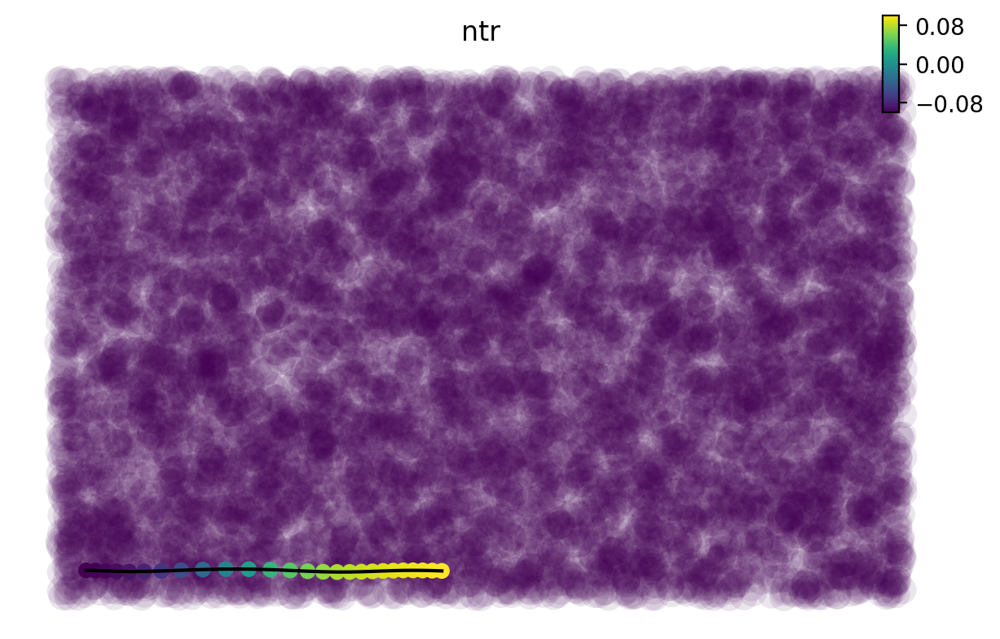

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 14.702691
|-----> [iterating through 1 pairs] completed [10.3548s]
|-----> [least action path] completed [10.3560s]
Saving figure to figure/kinetic_heatmap_30_A_B.pdf...
Done


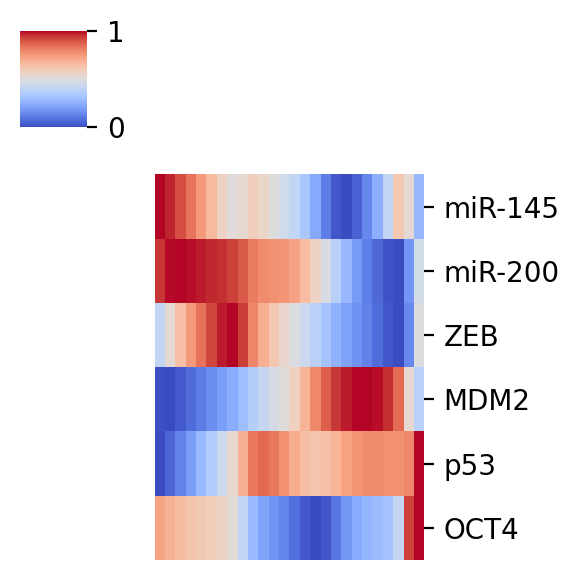

[[5383 7068 5342 6423 5553]] -> [[5643  810 1364 7958 6527]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 19.405796
|-----> [iterating through 1 pairs] completed [2.4194s]
|-----> [least action path] completed [2.4205s]


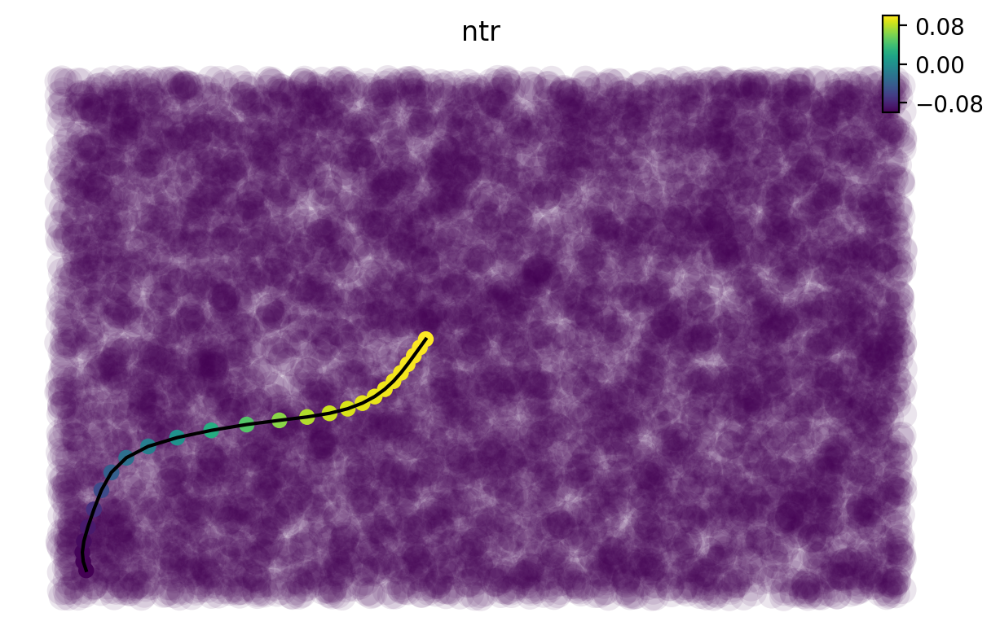

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 9.224767
|-----> [iterating through 1 pairs] completed [10.8213s]
|-----> [least action path] completed [10.8225s]
Saving figure to figure/kinetic_heatmap_30_A_C.pdf...
Done


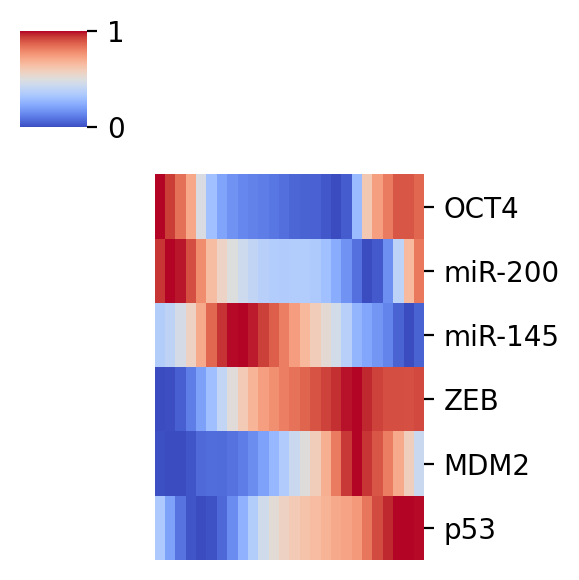

[[5383 7068 5342 6423 5553]] -> [[3836 5497 3518 9202 8323]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 7.710695
|-----> [iterating through 1 pairs] completed [2.3290s]
|-----> [least action path] completed [2.3301s]


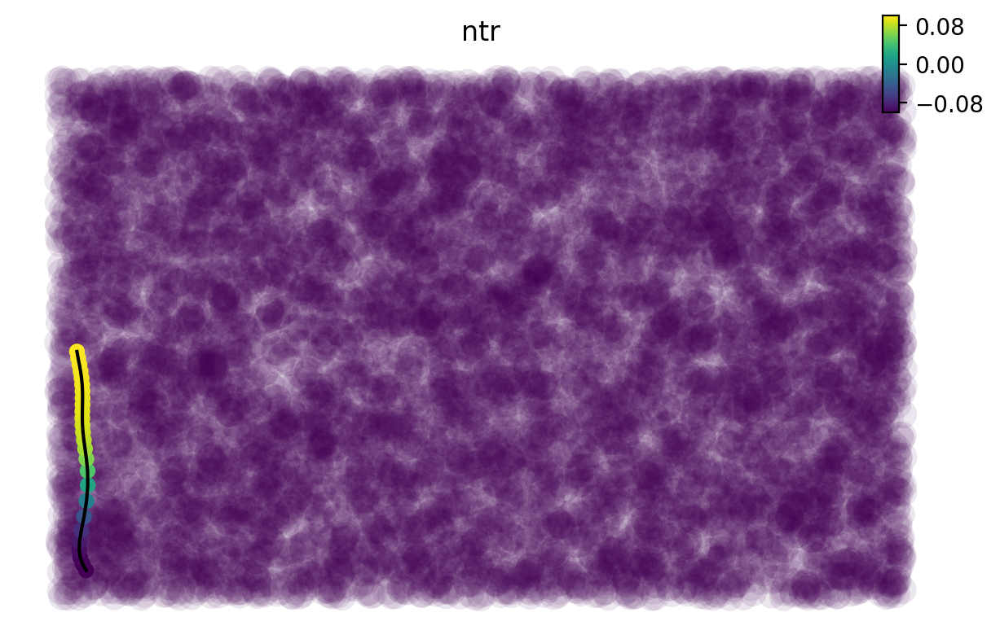

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 22.377145
|-----> [iterating through 1 pairs] completed [11.0682s]
|-----> [least action path] completed [11.0693s]
Saving figure to figure/kinetic_heatmap_30_A_D.pdf...
Done


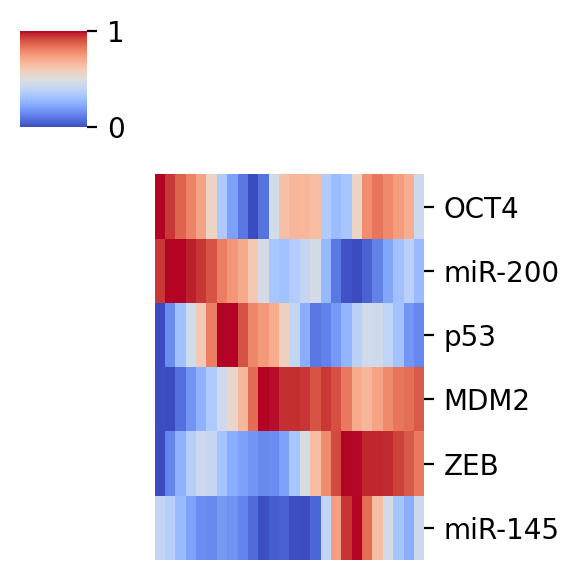

[[5383 7068 5342 6423 5553]] -> [[5322 8830 2506 7751 4364]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 0.047503
|-----> [iterating through 1 pairs] completed [0.2321s]
|-----> [least action path] completed [0.2329s]


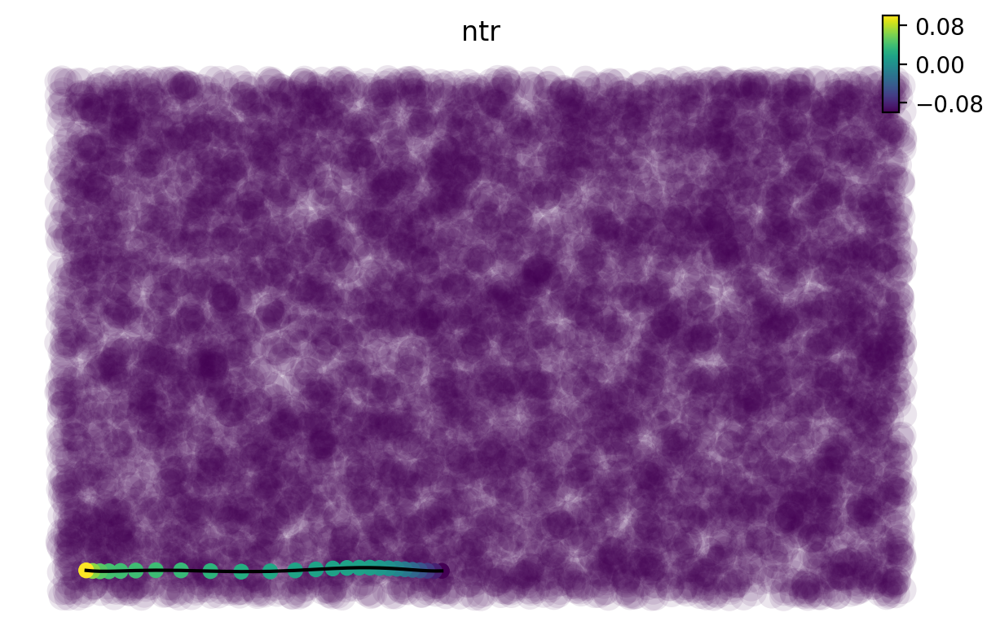

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 2.580635
|-----> [iterating through 1 pairs] completed [2.9157s]
|-----> [least action path] completed [2.9169s]
Saving figure to figure/kinetic_heatmap_30_B_A.pdf...
Done


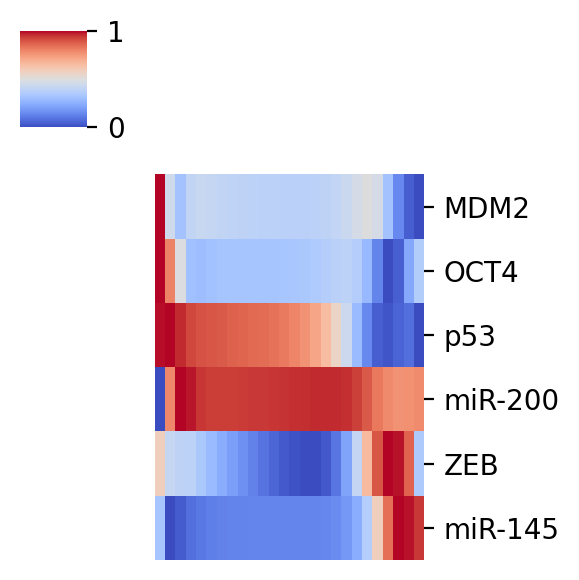

[[5643  810 1364 7958 6527]] -> [[5383 7068 5342 6423 5553]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 8.036541
|-----> [iterating through 1 pairs] completed [0.2272s]
|-----> [least action path] completed [0.2280s]


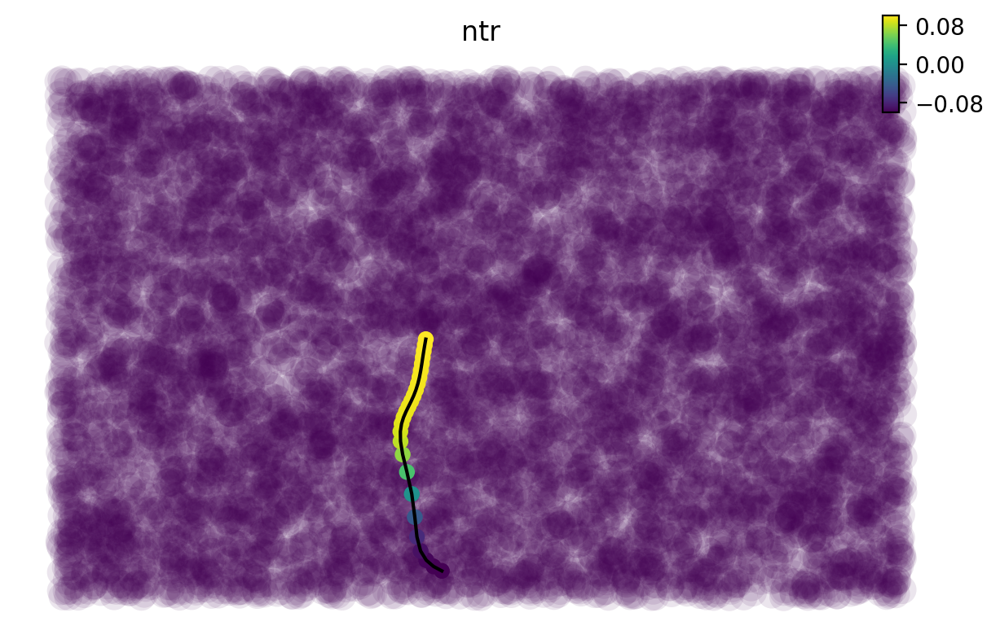

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 45.596470
|-----> [iterating through 1 pairs] completed [1.2838s]
|-----> [least action path] completed [1.2854s]
Saving figure to figure/kinetic_heatmap_30_B_C.pdf...
Done


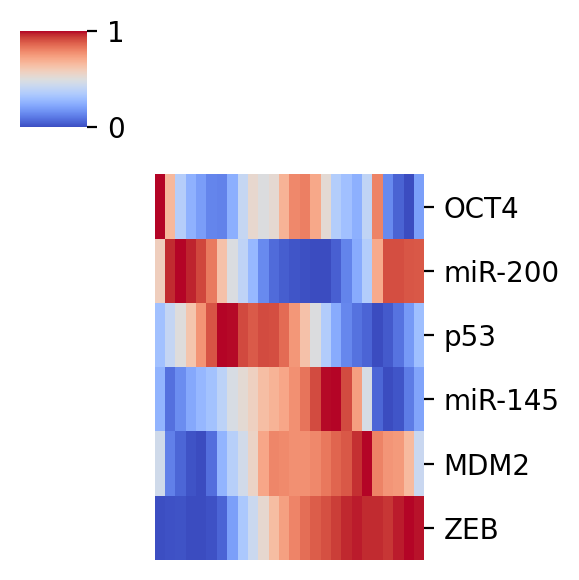

[[5643  810 1364 7958 6527]] -> [[3836 5497 3518 9202 8323]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 8.019211
|-----> [iterating through 1 pairs] completed [0.2494s]
|-----> [least action path] completed [0.2507s]


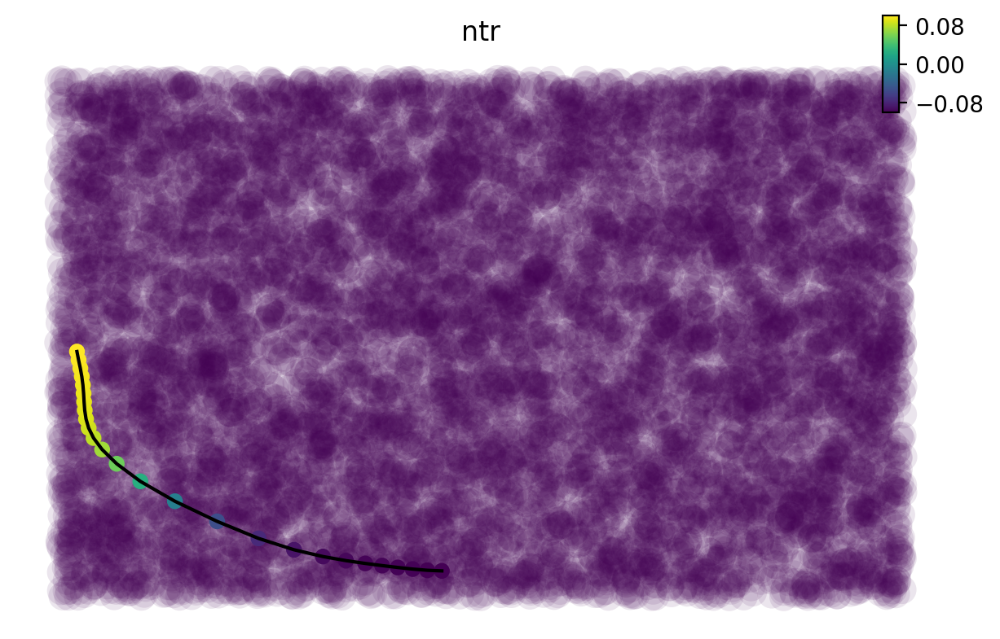

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 15.735019
|-----> [iterating through 1 pairs] completed [1.4935s]
|-----> [least action path] completed [1.4951s]
Saving figure to figure/kinetic_heatmap_30_B_D.pdf...
Done


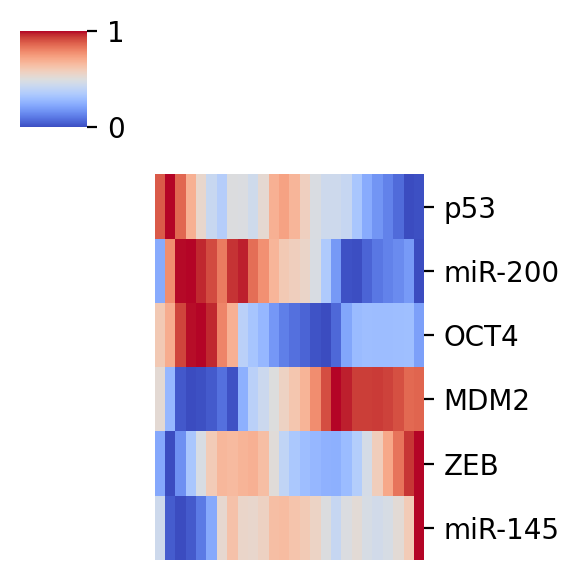

[[5643  810 1364 7958 6527]] -> [[5322 8830 2506 7751 4364]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 0.744399
|-----> [iterating through 1 pairs] completed [0.2443s]
|-----> [least action path] completed [0.2455s]


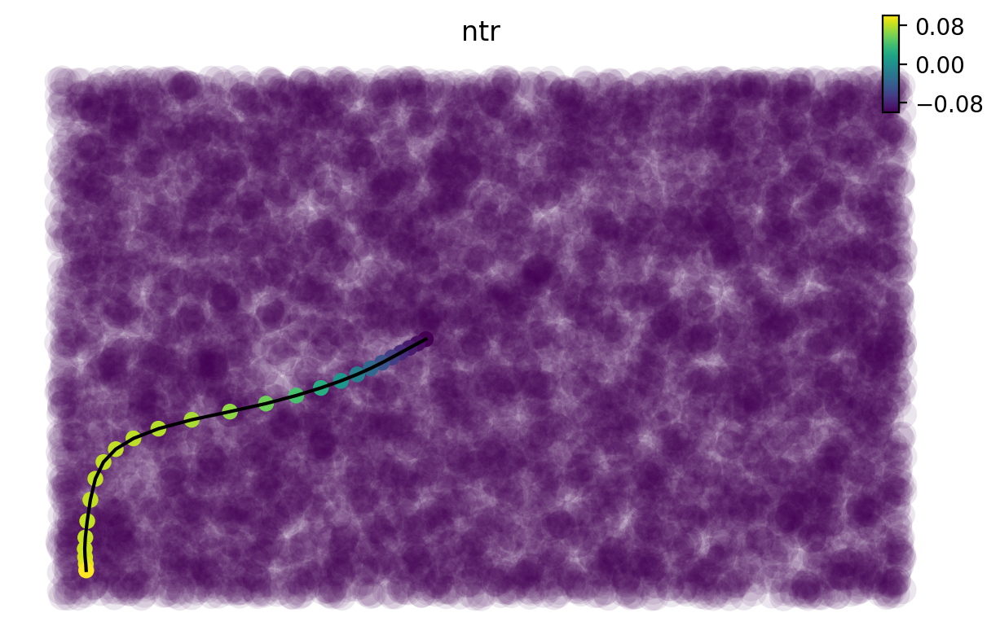

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 26.797844
|-----> [iterating through 1 pairs] completed [1.5829s]
|-----> [least action path] completed [1.5845s]
Saving figure to figure/kinetic_heatmap_30_C_A.pdf...
Done


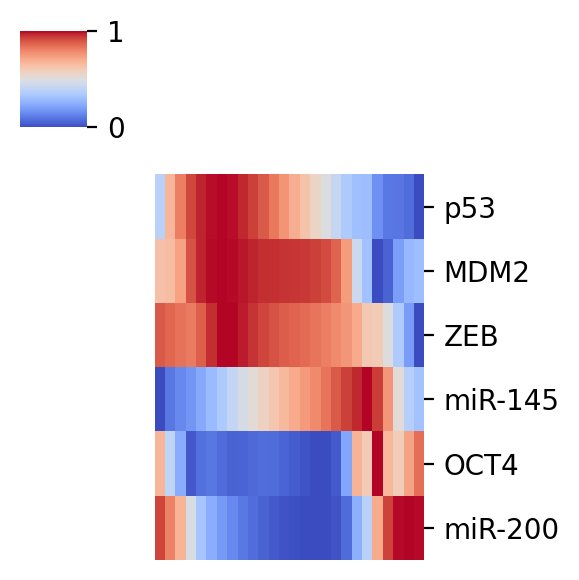

[[3836 5497 3518 9202 8323]] -> [[5383 7068 5342 6423 5553]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 0.887282
|-----> [iterating through 1 pairs] completed [0.2374s]
|-----> [least action path] completed [0.2386s]


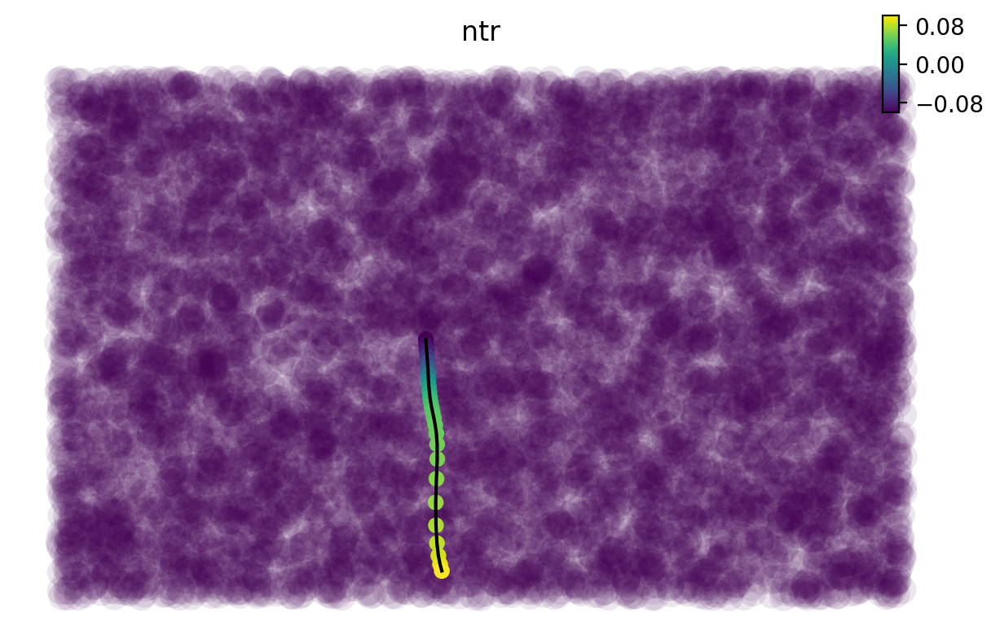

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 20.159288
|-----> [iterating through 1 pairs] completed [1.6692s]
|-----> [least action path] completed [1.6708s]
Saving figure to figure/kinetic_heatmap_30_C_B.pdf...
Done


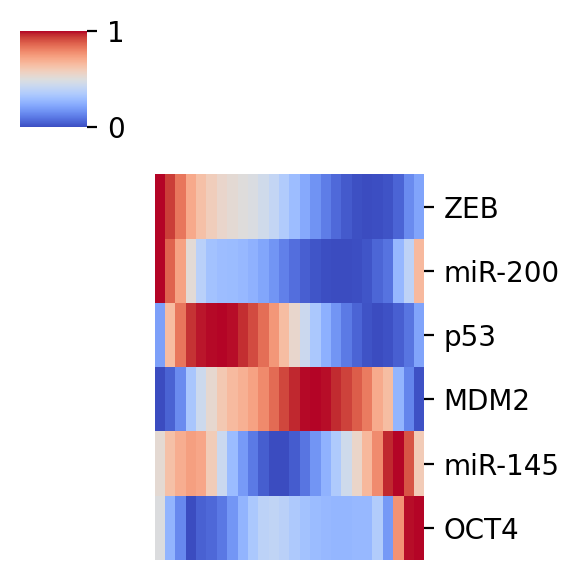

[[3836 5497 3518 9202 8323]] -> [[5643  810 1364 7958 6527]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 0.018760
|-----> [iterating through 1 pairs] completed [0.2585s]
|-----> [least action path] completed [0.2598s]


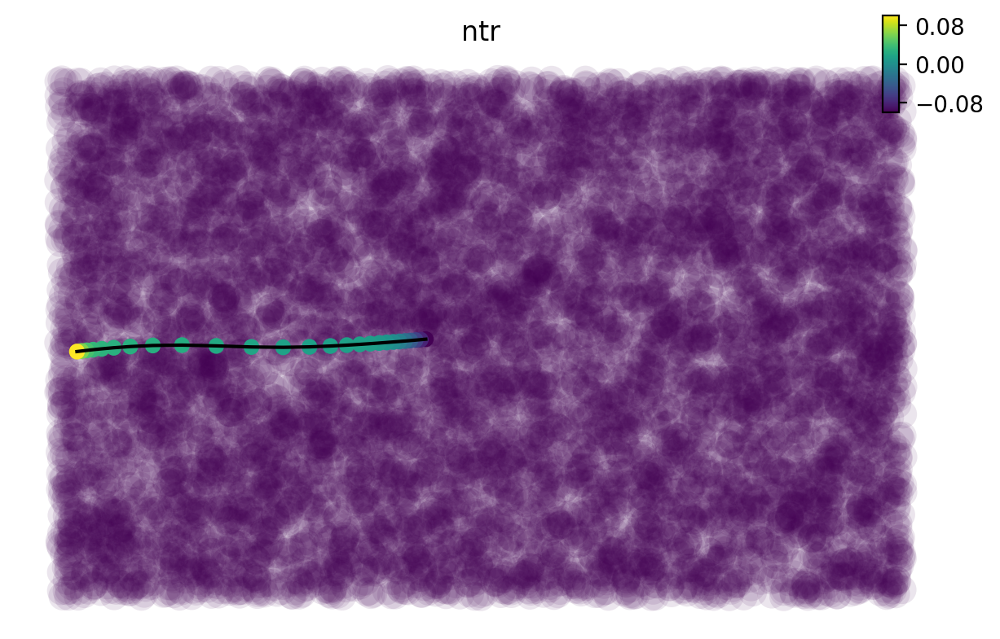

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 18.245237
|-----> [iterating through 1 pairs] completed [0.9816s]
|-----> [least action path] completed [0.9832s]
Saving figure to figure/kinetic_heatmap_30_C_D.pdf...
Done


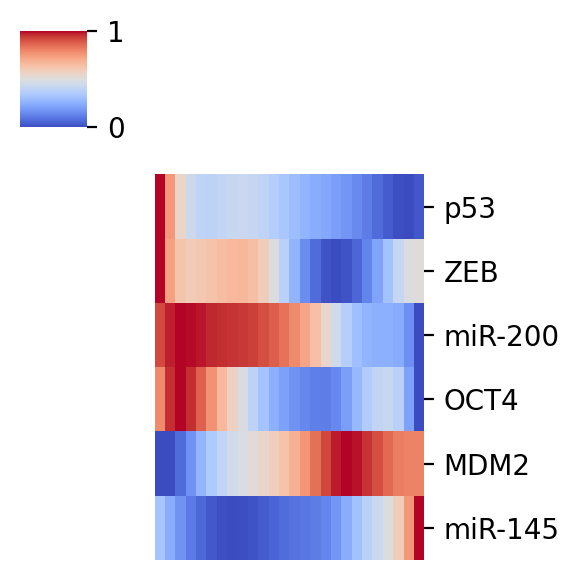

[[3836 5497 3518 9202 8323]] -> [[5322 8830 2506 7751 4364]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 0.362359
|-----> [iterating through 1 pairs] completed [0.2443s]
|-----> [least action path] completed [0.2459s]


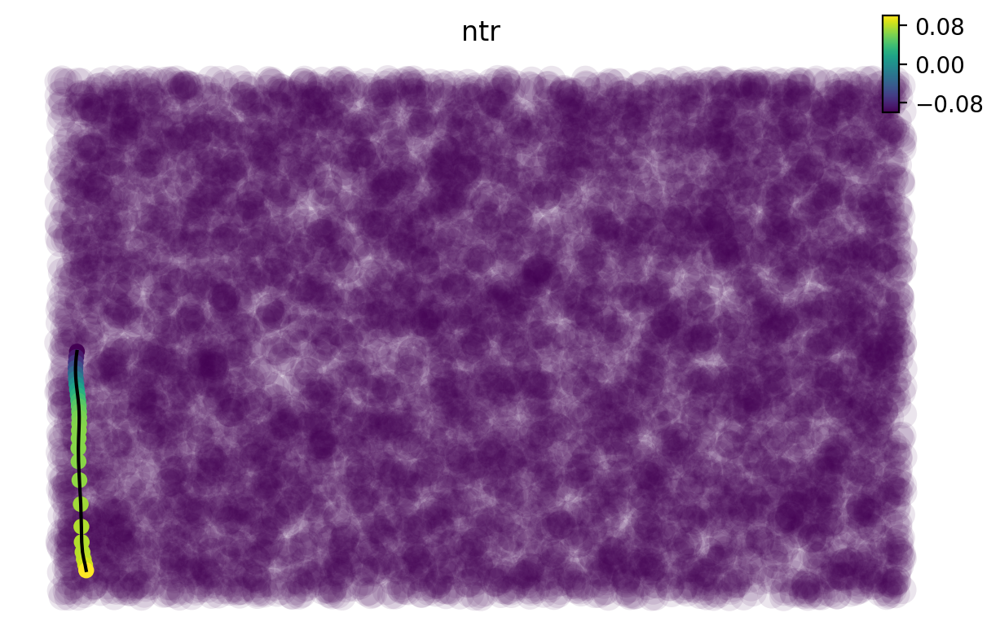

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 2.322836
|-----> [iterating through 1 pairs] completed [2.5172s]
|-----> [least action path] completed [2.5188s]
Saving figure to figure/kinetic_heatmap_30_D_A.pdf...
Done


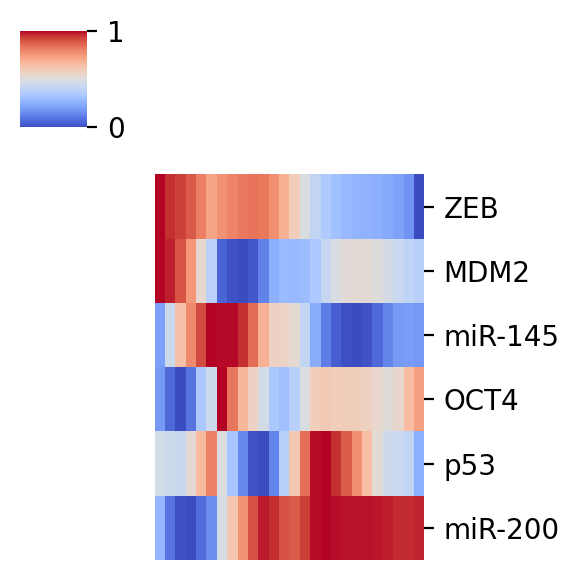

[[5322 8830 2506 7751 4364]] -> [[5383 7068 5342 6423 5553]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 12.166022
|-----> [iterating through 1 pairs] completed [0.2517s]
|-----> [least action path] completed [0.2529s]


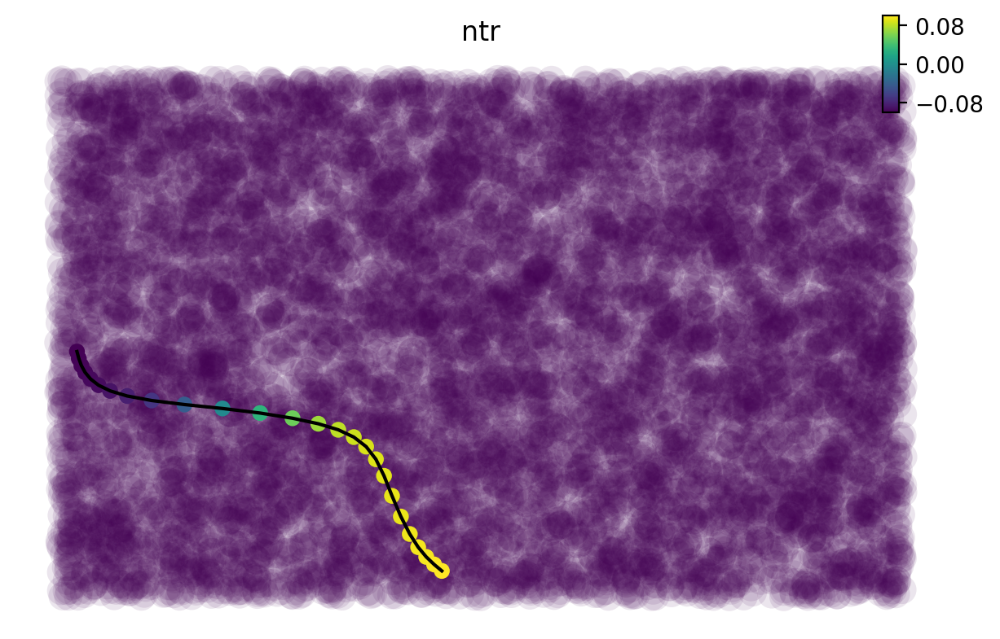

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 27.539514
|-----> [iterating through 1 pairs] completed [1.5074s]
|-----> [least action path] completed [1.5090s]
Saving figure to figure/kinetic_heatmap_30_D_B.pdf...
Done


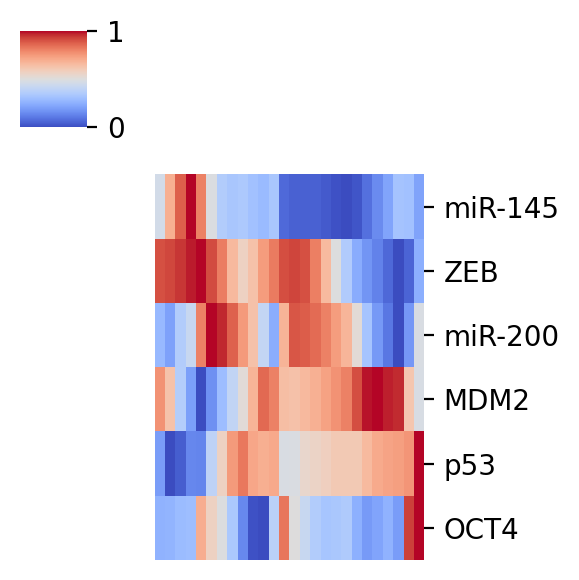

[[5322 8830 2506 7751 4364]] -> [[5643  810 1364 7958 6527]]
|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 12.271023
|-----> [iterating through 1 pairs] completed [0.2685s]
|-----> [least action path] completed [0.2698s]


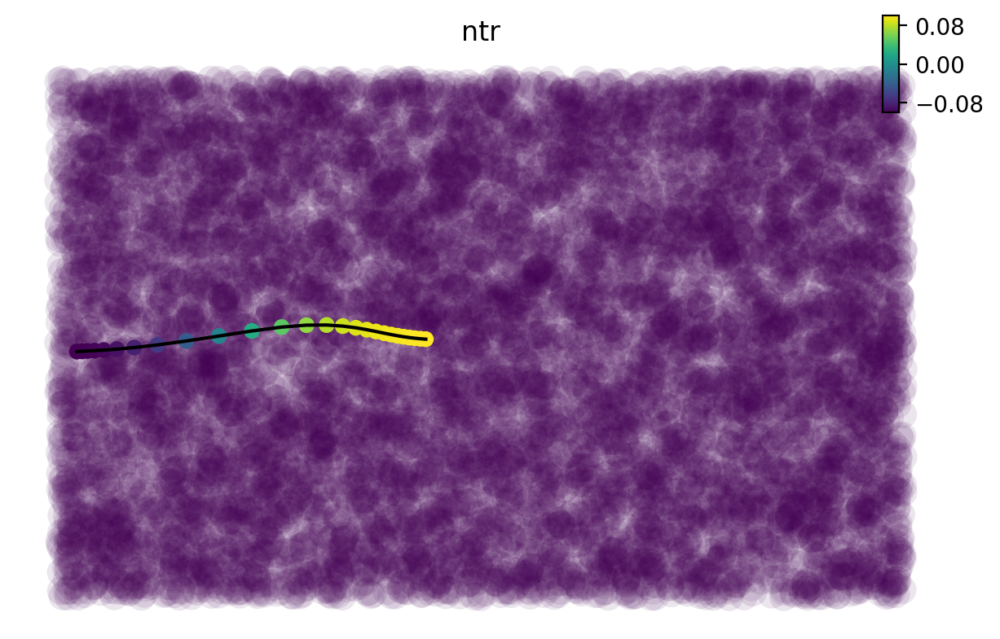

|-----> searching for the least action path...
|-----> [iterating through 1 pairs] in progress: 100.0000%|-----------> initializing path with the shortest path in the graph built from the velocity transition matrix...
|-----------> optimizing for least action path...
|-----> optimal action: 12.358899
|-----> [iterating through 1 pairs] completed [0.9608s]
|-----> [least action path] completed [0.9624s]
Saving figure to figure/kinetic_heatmap_30_D_C.pdf...
Done


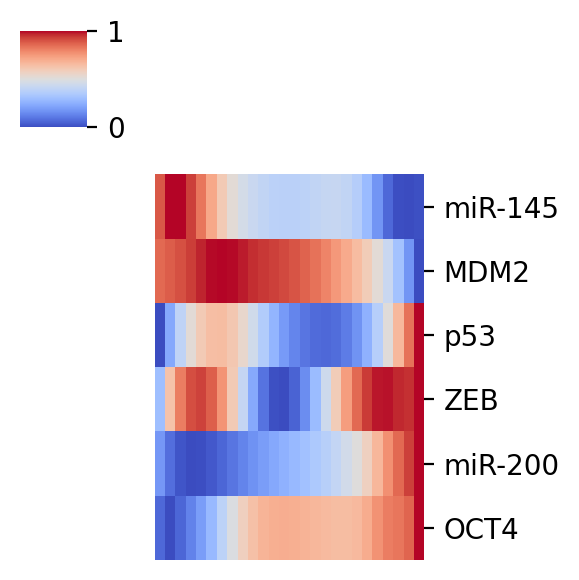

[[5322 8830 2506 7751 4364]] -> [[3836 5497 3518 9202 8323]]


In [297]:
from dynamo.tools.utils import nearest_neighbors

fixed_points = adata.uns['VecFld_umap']['Xss']

A_cells_indices = nearest_neighbors(fixed_points[0], adata.obsm["X_umap"])
B_cells_indices = nearest_neighbors(fixed_points[1], adata.obsm["X_umap"])
C_cells_indices = nearest_neighbors(fixed_points[2], adata.obsm["X_umap"])
D_cells_indices = nearest_neighbors(fixed_points[3], adata.obsm["X_umap"])

dyn.tl.neighbors(adata, basis="umap", result_prefix="umap")

dyn.dynamo_logger.main_silence()
transition_graph = {}
cell_type = ["A", "B", "C", "D"]
start_cell_indices = [
    A_cells_indices,
    B_cells_indices,
    C_cells_indices,
    D_cells_indices,
]
end_cell_indices = start_cell_indices
for i, start in enumerate(start_cell_indices):
    for j, end in enumerate(end_cell_indices):
        if start is not end:
            min_lap_t = True if i == 0 else False
            dyn.pd.least_action(
                adata,
                [adata.obs_names[start[0]][0]],
                [adata.obs_names[end[0]][0]],
                basis="umap",
                adj_key="umap_distances",
                min_lap_t= min_lap_t,
                num_t=20, 
                EM_steps=2,
                D=0.01,
                n_points=24, 
            )
            dyn.pl.least_action(adata, basis="umap")
            lap = dyn.pd.least_action(
                adata,
                [adata.obs_names[start[0]][0]],
                [adata.obs_names[end[0]][0]],
                basis="pca",
                adj_key="cosine_transition_matrix",
                min_lap_t=min_lap_t,
                num_t=20, 
                EM_steps=2,
                D=0.01,
                n_points=24, 
            )
            dyn.pl.kinetic_heatmap(
                adata,
                basis="pca",
                mode="lap",
                genes=adata.var_names[adata.var.use_for_transition],
                project_back_to_high_dim=True,
                show_colorbar=True,
                xticklabels=False,
                yticklabels=True,
                color_map="coolwarm",
                figsize=(3,3),
                save_show_or_return='all',
                save_kwargs={'path': 'figure/'+cell_type[i]+ "_" + cell_type[j], 
                            'prefix': 'kinetic_heatmap_30', 
                            'dpi': None, 
                            'ext': 'pdf', 
                            'transparent': True, 
                            'close': True, 
                            'verbose': True}
            )
            # The `GeneTrajectory` class can be used to output trajectories for any set of genes of interest
            gtraj = dyn.pd.GeneTrajectory(adata)
            gtraj.from_pca(lap.X, t=lap.t)
            gtraj.calc_msd()
            ranking = dyn.vf.rank_genes(adata, "traj_msd")

            print(start, "->", end)
            genes = ranking[:6]["all"].to_list()
            arr = gtraj.select_gene(genes)

            #dyn.pl.multiplot(lambda k: [plt.plot(arr[k, :]), plt.title(genes[k])], np.arange(len(genes)))

            transition_graph[cell_type[i] + "->" + cell_type[j]] = {
                "LAP_umap": adata.uns["LAP_umap"],
                "LAP_pca": adata.uns["LAP_pca"],
                "ranking": ranking,
                "genes": genes,
                "arr": arr,
                "kinetics_heatmap":adata.uns['kinetics_heatmap'],
            }

In [298]:
from dynamo.plot.utils import map2color
def plot_savelap_umap(paths):
    fig, ax = plt.subplots(figsize=(5, 5))
    ax = dyn.pl.topography(
        adata, markersize=500, 
        basis="umap", 
        save_show_or_return="return", 
        ax=ax, 
        fps_basis="umap", 
        color="ntr",
        pointsize=0.05,
        alpha=0.5,
        streamline_alpha=1, 
        frontier=False,
        xlim=([-0.01,1.2]),
        ylim=(-0.01,1.3),
        figsize=(5,5),
    )
    #ax = ax[0]
    x, y = 0, 1

    # plot paths
    for path in paths:
        lap_dict = transition_graph[path]["LAP_umap"]
        for prediction, action in zip(lap_dict["prediction"], lap_dict["action"]):
            ax.scatter(*prediction[:, [x, y]].T, c=map2color(action))
            ax.plot(*prediction[:, [x, y]].T, c="k")
    plt.savefig('figure/cancer_LAP_umap.pdf') 
    plt.show()

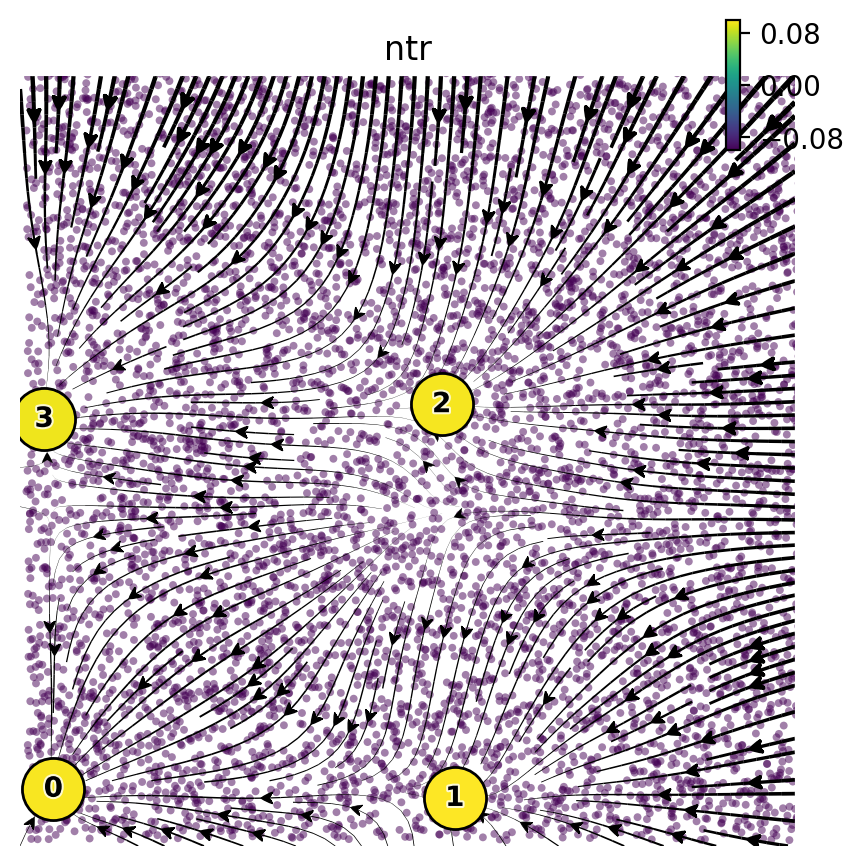

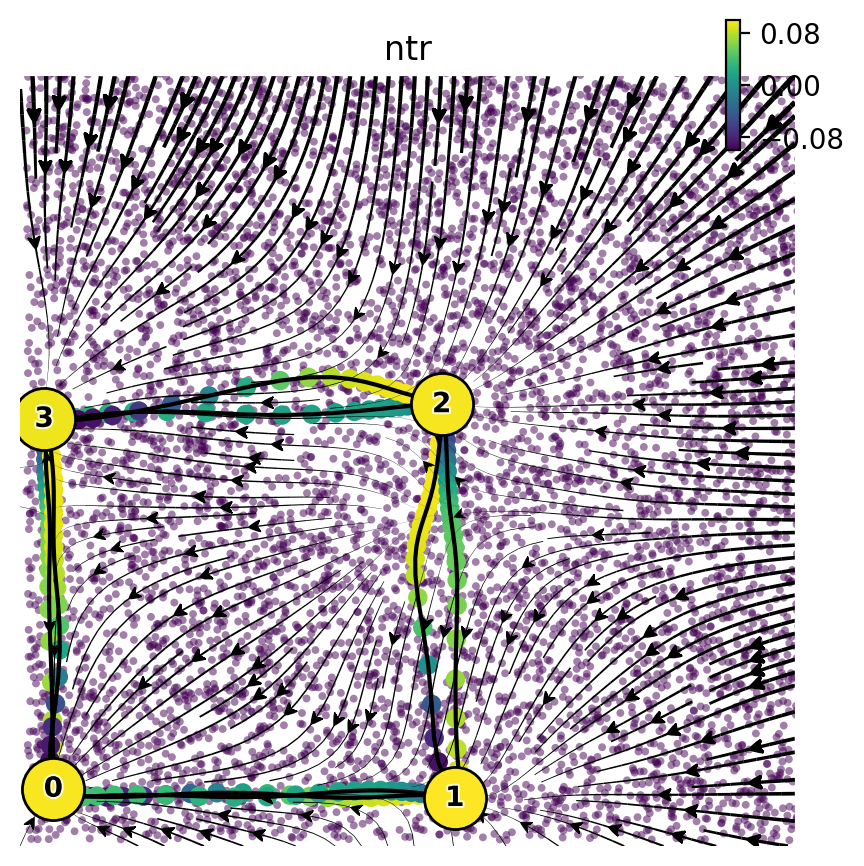

In [300]:
plot_savelap_umap(["A->B", "B->A", "B->C", "C->B", "C->D", "D->C", "D->A", "A->D"])

In [310]:
from scipy.io import savemat
savemat('cancer_transition_graph.mat', transition_graph)

In [311]:
from scipy.io import savemat
savemat('cancer_transition_graph.mat', {'A_B':transition_graph['A->B'],
                                       'B_A':transition_graph['B->A'],
                                       'B_C':transition_graph['B->C'],
                                       'C_B':transition_graph['C->B'],
                                       'C_D':transition_graph['C->D'],
                                       'D_C':transition_graph['D->C'],
                                       'D_A':transition_graph['D->A'],
                                       'A_D':transition_graph['A->D'],})

In [2]:
import scipy.io
from scipy import optimize

In [3]:
transition_graph = scipy.io.loadmat("cancer_transition_graph.mat")
transition_graph

{'__header__': b'MATLAB 5.0 MAT-file Platform: posix, Created on: Wed Apr  3 00:19:34 2024',
 '__version__': '1.0',
 '__globals__': [],
 'A_B': array([[(array([[(array([[0.04917778, 0.07669741]]), array(['cell_5383'], dtype='<U9'), array([[0.        , 0.2897936 , 0.57958721, 0.86938081, 1.15917441,
                         1.44896802, 1.73876162, 2.02855522, 2.31834883, 2.60814243,
                         2.89793603, 3.18772964, 3.47752324, 3.76731684, 4.05711045,
                         4.34690405, 4.63669765, 4.92649126, 5.21628486, 5.50607846,
                         5.79587207, 6.08566567, 6.37545927, 6.66525288, 6.95504648,
                         7.24484008]]), array([[1.00000000e+00, 1.07465867e+00, 1.20825634e+00, 1.46092115e+00,
                         1.97940443e+00, 3.17472691e+00, 6.39154854e+00, 1.67501314e+01,
                         5.59084211e+01, 2.14981210e+02, 8.15375022e+02, 2.64184118e+03,
                         6.79897856e+03, 1.39378500e+04, 2.37517157e+0

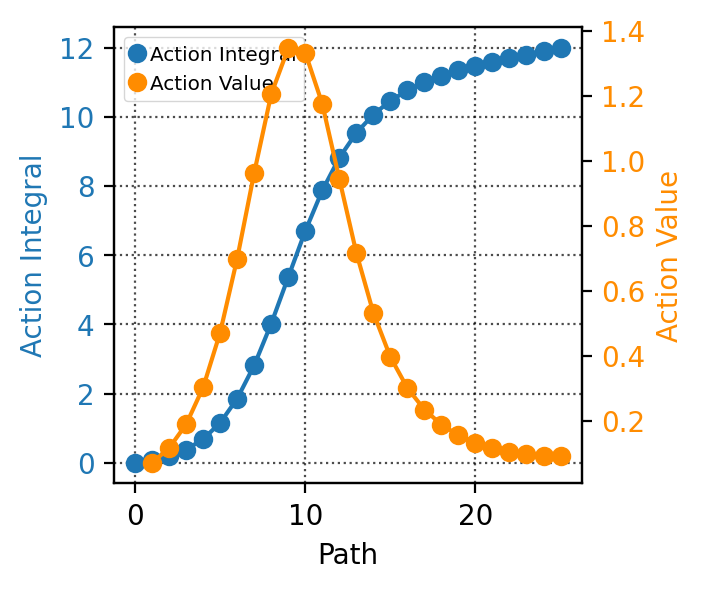

In [98]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.size'] = 10
# Provided array of action integrals
umap_action_integrals = np.array([
    0., 0.07200309, 0.18917828, 0.37906716, 0.682796,
    1.15522162, 1.85497658, 2.8184061, 4.02371501, 5.37055063,
    6.70364816, 7.87923137, 8.82452767, 9.54236344, 10.07541005,
    10.47265524, 10.77440979, 11.00984756, 11.19905171, 11.35568065,
    11.48912087, 11.60602103, 11.71135231, 11.809148, 11.90303885,
    11.99667426
])

# Compute action values (differences between successive action integrals)
umap_action_values = np.diff(umap_action_integrals)

# Creating the plot
#fig, ax1 = plt.subplots(figsize=(3.5, 3), dpi=150)
fig=plt.figure(figsize=(3, 3))
ax1 = fig.add_subplot(111)
# Plot action integral values
color_integral = '#1f77b4'
ax1.plot(range(len(umap_action_integrals)), umap_action_integrals, 
         color=color_integral, marker='o', label='Action Integral')
ax1.set_xlabel('Path', fontsize=10)
ax1.set_ylabel('Action Integral', color=color_integral, fontsize=10)
ax1.tick_params(axis='y', labelcolor=color_integral, labelsize=10)
ax1.tick_params(axis='x', labelsize=10)

# Secondary y-axis for action values
ax2 = ax1.twinx()
color_values = 'darkorange'
ax2.plot(range(1, len(umap_action_integrals)), umap_action_values, 
         color=color_values, marker='o', linestyle='-', label='Action Value')
ax2.set_ylabel('Action Value', color=color_values, fontsize=10)
ax2.tick_params(axis='y', labelcolor=color_values, labelsize=10)

# Combine legends from both axes into one
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='best')

ax1.grid(True, linestyle=':', linewidth=0.8, alpha=0.7)

#plt.tight_layout()
plt.savefig('figure/CANCER_vecfld_action_A_B_umap.pdf', bbox_inches='tight')
plt.show()

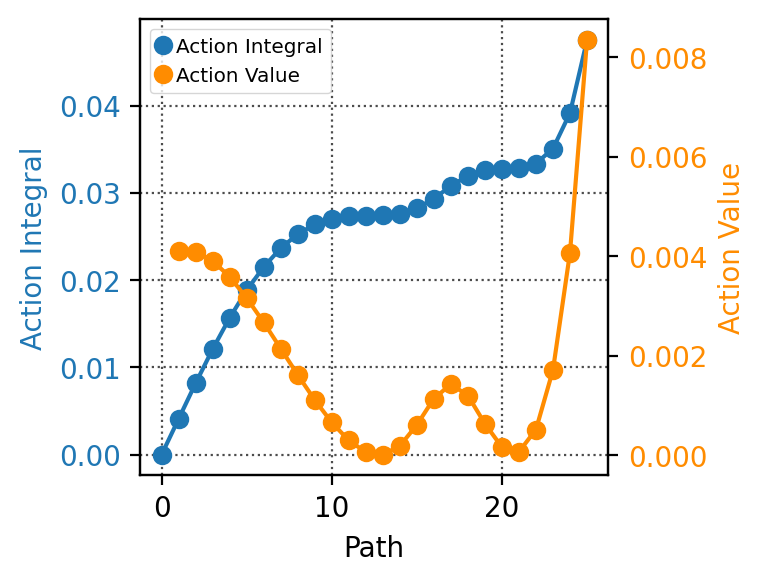

In [96]:
# Plotting the provided array of action values
import matplotlib.pyplot as plt
# Provided array of action values
umap_action_integrals = np.array([0.        , 0.00409815, 0.00818782, 0.01209678, 0.01568404,
                        0.01884611, 0.0215164 , 0.02366145, 0.02527727, 0.02638804,
                        0.02704784, 0.02734515, 0.02740956, 0.02742028, 0.02760855,
                        0.02821821, 0.02935739, 0.03078614, 0.03198495, 0.03261895,
                        0.03278097, 0.03285071, 0.03336815, 0.03508356, 0.03915871,
                        0.04750268])

umap_action_values = np.diff(umap_action_integrals)
#pca_action_values = np.append(0, pca_action_values)
# Creating the plot
fig=plt.figure(figsize=(3, 3))
ax1 = fig.add_subplot(111)
# Plot action integral values
color_integral = '#1f77b4'
ax1.plot(range(len(umap_action_integrals)), umap_action_integrals, 
         color=color_integral, marker='o', label='Action Integral')
ax1.set_xlabel('Path', fontsize=10)
ax1.set_ylabel('Action Integral', color=color_integral, fontsize=10)
ax1.tick_params(axis='y', labelcolor=color_integral, labelsize=10)
ax1.tick_params(axis='x', labelsize=10)

# Secondary y-axis for action values
ax2 = ax1.twinx()
color_values = 'darkorange'
ax2.plot(range(1, len(umap_action_integrals)), umap_action_values, 
         color=color_values, marker='o', linestyle='-', label='Action Value')
ax2.set_ylabel('Action Value', color=color_values, fontsize=10)
ax2.tick_params(axis='y', labelcolor=color_values, labelsize=10)

# Combine legends from both axes into one
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='best')

ax1.grid(True, linestyle=':', linewidth=0.8, alpha=0.7)

#plt.tight_layout()
plt.savefig('figure/CANCER_vecfld_action_B_A_umap.pdf', bbox_inches='tight')
plt.show()

## 6-gene model ODE-based HJ LAP 

In [70]:
VecFld_1_2 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__1_2.mat")
VecFld_2_3 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__2_3.mat")
VecFld_3_4 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__3_4.mat")
VecFld_4_1 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__4_1.mat")
VecFld_4_3 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__4_3.mat")
VecFld_3_2 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__3_2.mat")
VecFld_2_1 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__2_1.mat")
VecFld_1_4 = scipy.io.loadmat("pathabs2_SHJ_0.01_25__1_4.mat")

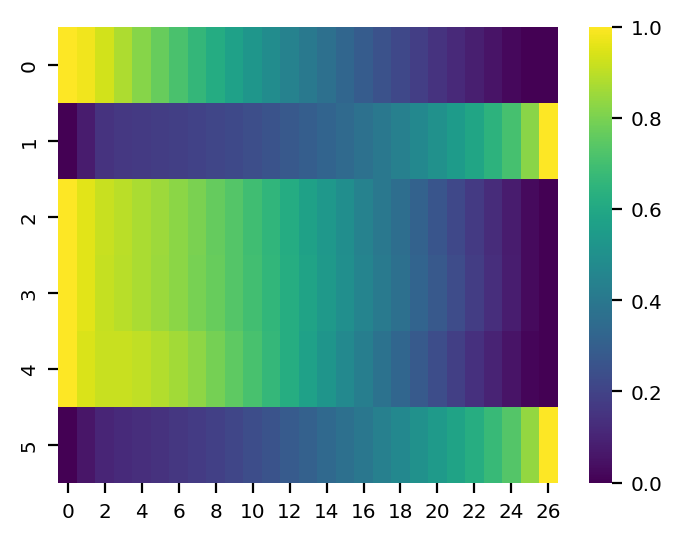

In [116]:
import seaborn as sns
data=VecFld_3_4['path']
normalized_data = (data - data.min(axis=1, keepdims=True)) / (data.max(axis=1, keepdims=True) - data.min(axis=1, keepdims=True))

plt.figure(figsize=(4, 3))
sns.heatmap(normalized_data, cmap='viridis', annot=False, fmt=".2f", linewidths=0.0)
plt.savefig('figure/expression_normaliz_SHJ_action_3_4.pdf', bbox_inches='tight')
plt.show()

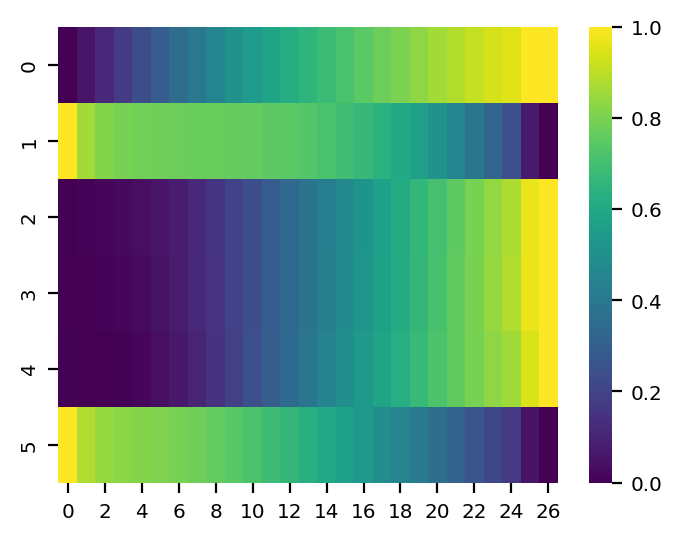

In [117]:
import seaborn as sns
data=VecFld_4_3['path']
normalized_data = (data - data.min(axis=1, keepdims=True)) / (data.max(axis=1, keepdims=True) - data.min(axis=1, keepdims=True))

plt.figure(figsize=(4, 3))
sns.heatmap(normalized_data, cmap='viridis', annot=False, fmt=".2f", linewidths=0.0)
plt.savefig('figure/expression_normaliz_SHJ_action_4_3.pdf', bbox_inches='tight')
plt.show()

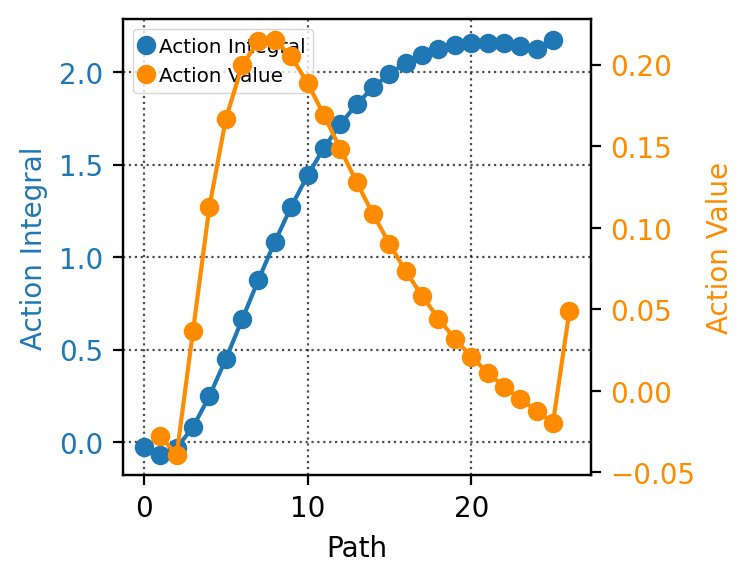

In [82]:
# Plotting the provided array of action values

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
# Provided array of action values
# Creating the plot
fig=plt.figure(figsize=(3, 3))
ax1 = fig.add_subplot(111)
ax1.plot(VecFld_3_4['shj1'].cumsum(), color='#1f77b4', marker='o', label='Action Integral')
ax1.set_xlabel('Path', fontsize=10)
ax1.set_ylabel('Action Integral', color=color_integral, fontsize=10)
ax1.tick_params(axis='y', labelcolor=color_integral, labelsize=10)
ax1.tick_params(axis='x', labelsize=10)

ax2 = ax1.twinx()
ax2.plot(np.linspace(1,26,26), VecFld_3_4['shj1'], color='darkorange', marker='o', label='Action Value')
ax2.set_ylabel('Action Value', color=color_values, fontsize=10)
ax2.tick_params(axis='y', labelcolor=color_values, labelsize=10)

# Combine legends from both axes into one
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='best')

ax1.grid(True, linestyle=':', linewidth=0.8, alpha=0.7)
#plt.tight_layout()
plt.savefig('figure/CANCER_SHJ_action_3_4.pdf', bbox_inches='tight')
plt.show()

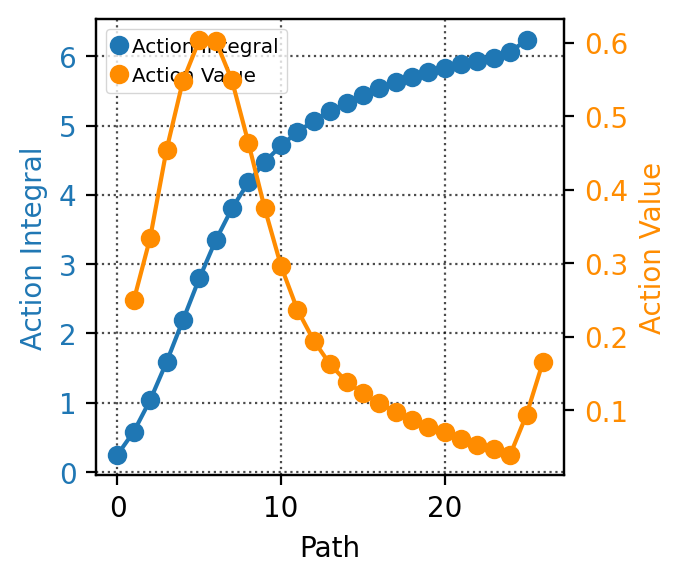

In [83]:
# Plotting the provided array of action values

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
# Provided array of action values
# Creating the plot
fig=plt.figure(figsize=(3, 3))
ax1 = fig.add_subplot(111)
ax1.plot(VecFld_4_3['shj1'].cumsum(), color='#1f77b4', marker='o', label='Action Integral')
ax1.set_xlabel('Path', fontsize=10)
ax1.set_ylabel('Action Integral', color=color_integral, fontsize=10)
ax1.tick_params(axis='y', labelcolor=color_integral, labelsize=10)
ax1.tick_params(axis='x', labelsize=10)

ax2 = ax1.twinx()
ax2.plot(np.linspace(1,26,26), VecFld_4_3['shj1'], color='darkorange', marker='o', label='Action Value')
ax2.set_ylabel('Action Value', color=color_values, fontsize=10)
ax2.tick_params(axis='y', labelcolor=color_values, labelsize=10)

# Combine legends from both axes into one
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='best')

ax1.grid(True, linestyle=':', linewidth=0.8, alpha=0.7)
#plt.tight_layout()
plt.savefig('figure/CANCER_SHJ_action_4_3.pdf', bbox_inches='tight')
plt.show()